<a href="https://colab.research.google.com/github/Fatis092/repo52/blob/main/Copy_of_YOLOv8_Licence_Plate_Character_Train_and_Predict.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:

# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES
# TO THE CORRECT LOCATION (/kaggle/input) IN YOUR NOTEBOOK,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

import os
import sys
from tempfile import NamedTemporaryFile
from urllib.request import urlopen
from urllib.parse import unquote, urlparse
from urllib.error import HTTPError
from zipfile import ZipFile
import tarfile
import shutil

CHUNK_SIZE = 40960
DATA_SOURCE_MAPPING = 'saudi-license-plate-characters:https%3A%2F%2Fstorage.googleapis.com%2Fkaggle-data-sets%2F3648691%2F6337926%2Fbundle%2Farchive.zip%3FX-Goog-Algorithm%3DGOOG4-RSA-SHA256%26X-Goog-Credential%3Dgcp-kaggle-com%2540kaggle-161607.iam.gserviceaccount.com%252F20240916%252Fauto%252Fstorage%252Fgoog4_request%26X-Goog-Date%3D20240916T150056Z%26X-Goog-Expires%3D259200%26X-Goog-SignedHeaders%3Dhost%26X-Goog-Signature%3D3488132a2b1616e757855c1dbe4216c59eed27d6cb1ef20263396a949ed2d23b3f3617a20c4a755f6f95e9e2501cb3e4d11d2a551850322fb9feeb29968f37f09629c116ef46348a4825eab8be1ecd70fd8fb48d4b6c7ee4e14cf3bc40a4faf57f303148ab3a86dab9957f44fce1156bfe68fff2dcb9b589a2fda743725123e873999c583c94aeeb77e82097a4ac79e6c3dfaacf242f8ccfabb6fb85b94f99c35d7d5d6884bd7f35e284168a4c613271fa5e9c926ca8e0b1cfe74e3ed98ce9feb135a19dbbaff46343d8850757d7eaf1f5a760ce2b36b328cda213885828b210c910dfe0a400bcd31246d3ba8e0ea107be3640a837274f223c4e773519b3bc77'

KAGGLE_INPUT_PATH='/kaggle/input'
KAGGLE_WORKING_PATH='/kaggle/working'
KAGGLE_SYMLINK='kaggle'

!umount /kaggle/input/ 2> /dev/null
shutil.rmtree('/kaggle/input', ignore_errors=True)
os.makedirs(KAGGLE_INPUT_PATH, 0o777, exist_ok=True)
os.makedirs(KAGGLE_WORKING_PATH, 0o777, exist_ok=True)

try:
  os.symlink(KAGGLE_INPUT_PATH, os.path.join("..", 'input'), target_is_directory=True)
except FileExistsError:
  pass
try:
  os.symlink(KAGGLE_WORKING_PATH, os.path.join("..", 'working'), target_is_directory=True)
except FileExistsError:
  pass

for data_source_mapping in DATA_SOURCE_MAPPING.split(','):
    directory, download_url_encoded = data_source_mapping.split(':')
    download_url = unquote(download_url_encoded)
    filename = urlparse(download_url).path
    destination_path = os.path.join(KAGGLE_INPUT_PATH, directory)
    try:
        with urlopen(download_url) as fileres, NamedTemporaryFile() as tfile:
            total_length = fileres.headers['content-length']
            print(f'Downloading {directory}, {total_length} bytes compressed')
            dl = 0
            data = fileres.read(CHUNK_SIZE)
            while len(data) > 0:
                dl += len(data)
                tfile.write(data)
                done = int(50 * dl / int(total_length))
                sys.stdout.write(f"\r[{'=' * done}{' ' * (50-done)}] {dl} bytes downloaded")
                sys.stdout.flush()
                data = fileres.read(CHUNK_SIZE)
            if filename.endswith('.zip'):
              with ZipFile(tfile) as zfile:
                zfile.extractall(destination_path)
            else:
              with tarfile.open(tfile.name) as tarfile:
                tarfile.extractall(destination_path)
            print(f'\nDownloaded and uncompressed: {directory}')
    except HTTPError as e:
        print(f'Failed to load (likely expired) {download_url} to path {destination_path}')
        continue
    except OSError as e:
        print(f'Failed to load {download_url} to path {destination_path}')
        continue

print('Data source import complete.')


[==================================================] 9130503 bytes downloaded
Downloaded and uncompressed: saudi-license-plate-characters
Data source import complete.


# YOLOv8 Licence Plate Character Train and Predict

In [ ]:
!rm -rf

In [ ]:
%pip install ultralytics

In [ ]:
import os
import cv2
import numpy as np
import pandas as pd
from tqdm import tqdm
from shutil import copyfile
import matplotlib.pyplot as plt
from PIL import Image
import ultralytics
from ultralytics import YOLO
ultralytics.checks()

Ultralytics YOLOv8.2.95 🚀 Python-3.10.12 torch-2.4.0+cu121 CPU (Intel Xeon 2.20GHz)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 33.0/107.7 GB disk)


# Check Annotation Data

In [ ]:
ipaths=[]
tpaths=[]
for dirname, _, filenames in os.walk('/kaggle/input/saudi-license-plate-characters/License-Characters-by-2-27classes/train'):
    for filename in filenames:
        if filename[-4:]=='jpeg':
            ipaths+=[os.path.join(dirname, filename)]
        elif filename[-4:]=='.txt':
            tpaths+=[os.path.join(dirname, filename)]
ipaths=sorted(ipaths)
tpaths=sorted(tpaths)
print(ipaths[0])
print(len(ipaths))

/kaggle/input/saudi-license-plate-characters/License-Characters-by-2-27classes/train/ckictsenl0000246a2itn28ts.jpeg
436


In [ ]:
boxdata=[]
boxfile=[]
for i in range(len(tpaths)):
    file=tpaths[i]
    boxdata+=[np.loadtxt(file)]
    boxfile+=[file[0:-4].split('/')[-1]]
print(boxdata[0])

[[          0     0.11488     0.56364    0.041575     0.61818]
 [          5     0.19803     0.52727    0.041575     0.67273]
 [          2     0.28884     0.49545     0.04814     0.75455]
 [          8     0.37856     0.49091     0.04814     0.74545]
 [         18     0.58972     0.50455    0.054705     0.73636]
 [         23     0.67943     0.50909    0.050328     0.70909]
 [         25     0.76696     0.53636    0.054705     0.69091]]


In [ ]:
BOX=pd.DataFrame()

for i in range(len(boxdata)):
    if type(boxdata[i][0])==np.float64:
        add=pd.DataFrame([boxdata[i]])
        add[5]=boxfile[i]
        BOX=pd.concat([BOX,add])
    else:
        add=pd.DataFrame(boxdata[i])
        add[5]=boxfile[i]
        BOX=pd.concat([BOX,add])

BOX2=BOX.reset_index(drop=True)
display(BOX2)
print(BOX2.iloc[:,0].max())

,0,1,2,3,4,5
0,0.0,0.114880,0.563636,0.041575,0.618182,ckictsenl0000246a2itn28ts
1,5.0,0.198031,0.527273,0.041575,0.672727,ckictsenl0000246a2itn28ts
2,2.0,0.288840,0.495455,0.048140,0.754545,ckictsenl0000246a2itn28ts
3,8.0,0.378556,0.490909,0.048140,0.745455,ckictsenl0000246a2itn28ts
4,18.0,0.589716,0.504545,0.054705,0.736364,ckictsenl0000246a2itn28ts
...,...,...,...,...,...,...
3623,4.0,0.418367,0.534247,0.102041,0.602740,ckn7dpc87001w3h66nfp0otgl
3624,9.0,0.540816,0.554795,0.102041,0.616438,ckn7dpc87001w3h66nfp0otgl
3625,23.0,0.693878,0.561644,0.102041,0.547945,ckn7dpc87001w3h66nfp0otgl
3626,12.0,0.821429,0.595890,0.091837,0.506849,ckn7dpc87001w3h66nfp0otgl


26.0


In [ ]:
N=list(range(27))
Name=[]
for i in range(27):
    Name+=[str(i).zfill(2)]
class_map=dict(zip(N,Name))

In [ ]:
for i in range(len(BOX2)):
    BOX2.iloc[i,0]=class_map[int(BOX2.iloc[i,0])]
display(BOX2)
display(BOX2.iloc[:,0].value_counts())

<ipython-input-9-f249c5bb189d>:2: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '00' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  BOX2.iloc[i,0]=class_map[int(BOX2.iloc[i,0])]


,0,1,2,3,4,5
0,00,0.114880,0.563636,0.041575,0.618182,ckictsenl0000246a2itn28ts
1,05,0.198031,0.527273,0.041575,0.672727,ckictsenl0000246a2itn28ts
2,02,0.288840,0.495455,0.048140,0.754545,ckictsenl0000246a2itn28ts
3,08,0.378556,0.490909,0.048140,0.745455,ckictsenl0000246a2itn28ts
4,18,0.589716,0.504545,0.054705,0.736364,ckictsenl0000246a2itn28ts
...,...,...,...,...,...,...
3623,04,0.418367,0.534247,0.102041,0.602740,ckn7dpc87001w3h66nfp0otgl
3624,09,0.540816,0.554795,0.102041,0.616438,ckn7dpc87001w3h66nfp0otgl
3625,23,0.693878,0.561644,0.102041,0.547945,ckn7dpc87001w3h66nfp0otgl
3626,12,0.821429,0.595890,0.091837,0.506849,ckn7dpc87001w3h66nfp0otgl


,count
0,
07,260
03,257
05,242
16,233
02,233
00,220
04,208
09,191
12,190


In [ ]:
def draw_box(n0):

    ipath=ipaths[n0]
    image=cv2.imread(ipath)
    H,W=image.shape[0],image.shape[1]
    file=ipath[0:-4].split('/')[-1]

    if BOX2[BOX2[5]==file] is not None:
        box=BOX2[BOX2[5]==file]
        box=box.reset_index(drop=True)

        for i in range(len(box)):
            label=box.iloc[i,0]
            x=box.iloc[i,1]
            y=box.iloc[i,2]
            w=box.iloc[i,3]
            h=box.iloc[i,4]
            x0=((x-w/2)*W).astype(int)
            y0=((y-h/2)*H).astype(int)
            x1=((x+w/2)*W).astype(int)
            y1=((y+h/2)*H).astype(int)
            cv2.rectangle(image,(x0,y0),(x1,y1),(0,255,0),1) #green

    #plt.imshow(image)
    #plt.show()

    return image

In [ ]:
images1=[]
for i in tqdm(range(len(ipaths))):#
    images1+=[draw_box(i)]


100%|██████████| 436/436 [00:02<00:00, 169.12it/s]


In [ ]:
from matplotlib import animation, rc
rc('animation', html='jshtml')

In [ ]:
def create_animation(ims):
    fig=plt.figure(figsize=(10,6))
    #plt.axis('off')
    im=plt.imshow(cv2.cvtColor(ims[0],cv2.COLOR_BGR2RGB))
    plt.close()
    def animate_func(i):
        im.set_array(cv2.cvtColor(ims[i],cv2.COLOR_BGR2RGB))
        return [im]
    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000//4)

In [ ]:
create_animation(images1)

# Split Train, Valid and Test

In [ ]:
os.makedirs('datasets', exist_ok=True)
os.makedirs('datasets/train', exist_ok=True)
os.makedirs('datasets/valid', exist_ok=True)
os.makedirs('datasets/test', exist_ok=True)

In [ ]:
for i in range(len(ipaths)):
    ipath=ipaths[i]
    ifile=ipath.split('/')[-1]
    tpath=tpaths[i]
    tfile=tpath.split('/')[-1]
    if i%4==1:
        copyfile(ipath, f'datasets/valid/{ifile}')
        copyfile(tpath, f'datasets/valid/{tfile}')
    elif i%4==2:
        copyfile(ipath, f'datasets/test/{ifile}')
        #copyfile(tpath, f'datasets/test/{tfile}')
    else:
        copyfile(ipath, f'datasets/train/{ifile}')
        copyfile(tpath, f'datasets/train/{tfile}')

# Create yaml file

In [ ]:
import yaml

plate_yaml = dict(
    train ='train',
    val ='valid',
    test='test',
    nc =27,
    names = Name
)

with open('plate.yaml', 'w') as outfile:
    yaml.dump(plate_yaml, outfile, default_flow_style=True)

%cat plate.yaml

{names: ['00', '01', '02', '03', '04', '05', '06', '07', 08, 09, '10', '11', '12',
    '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25',
    '26'], nc: 27, test: test, train: train, val: valid}


# Train

In [ ]:
model = YOLO("yolov8x.pt")

In [ ]:
!yolo task=detect mode=train model=yolov8x.pt data=plate.yaml epochs=40 imgsz=640

Ultralytics YOLOv8.2.95 🚀 Python-3.10.12 torch-2.4.0+cu121 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=detect, mode=train, model=yolov8x.pt, data=plate.yaml, epochs=40, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_w

# Result of Training

In [ ]:
!unzip '/content/archive (5).zip' -d '/content'

Archive:  /content/archive (5).zip
  inflating: /content/License-Characters-by-2-27classes/test/ckicup6z1000g246a7fphj2ry.jpeg  
  inflating: /content/License-Characters-by-2-27classes/test/ckicup6z1000g246a7fphj2ry.txt  
  inflating: /content/License-Characters-by-2-27classes/test/ckicup6z1000g246a7fphj2ry.xml  
  inflating: /content/License-Characters-by-2-27classes/test/ckicv7bge000i246amogy2uak.jpeg  
  inflating: /content/License-Characters-by-2-27classes/test/ckicv7bge000i246amogy2uak.txt  
  inflating: /content/License-Characters-by-2-27classes/test/ckicv7bge000i246amogy2uak.xml  
  inflating: /content/License-Characters-by-2-27classes/test/ckicz5mvn001m246adc3vvpi8.jpeg  
  inflating: /content/License-Characters-by-2-27classes/test/ckicz5mvn001m246adc3vvpi8.txt  
  inflating: /content/License-Characters-by-2-27classes/test/ckicz5mvn001m246adc3vvpi8.xml  
  inflating: /content/License-Characters-by-2-27classes/test/ckid0aey1002d246a4yttijxq.jpeg  
  inflating: /content/License-C

In [ ]:
tpaths2=[]
for dirname, _, filenames in os.walk('/content/License-Characters-by-2-27classes/train'):
    for filename in filenames:
        if filename[-4:]=='.png' or filename[-4:]=='.jpg':
            tpaths2+=[(os.path.join(dirname, filename))]
tpaths2=sorted(tpaths2)
print(tpaths2[0])

/content/License-Characters-by-2-27classes/train/ckicuf6jf000a246axa0bp4ut.png


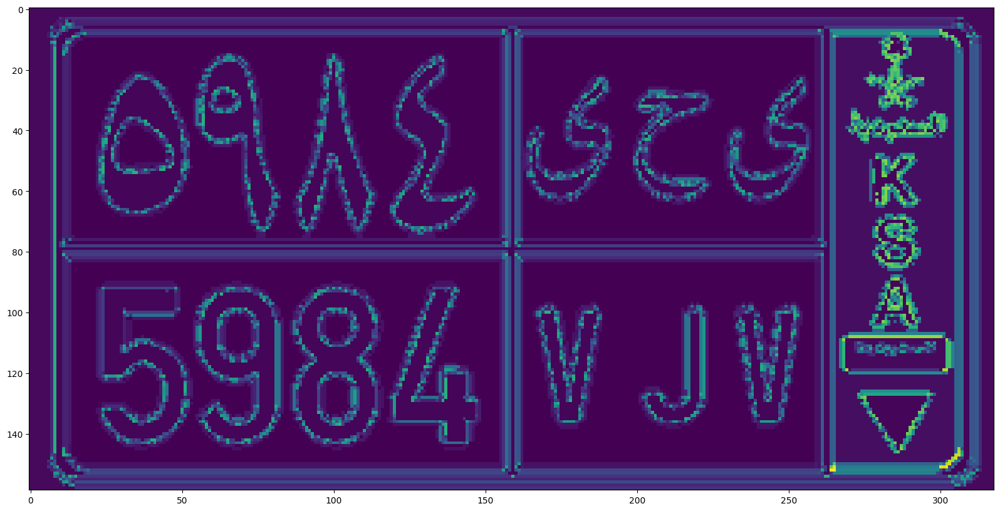

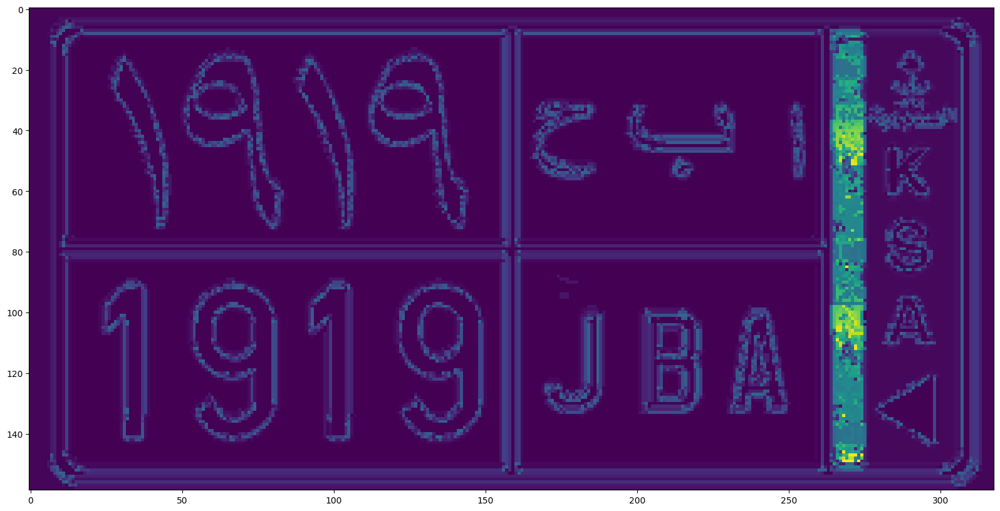

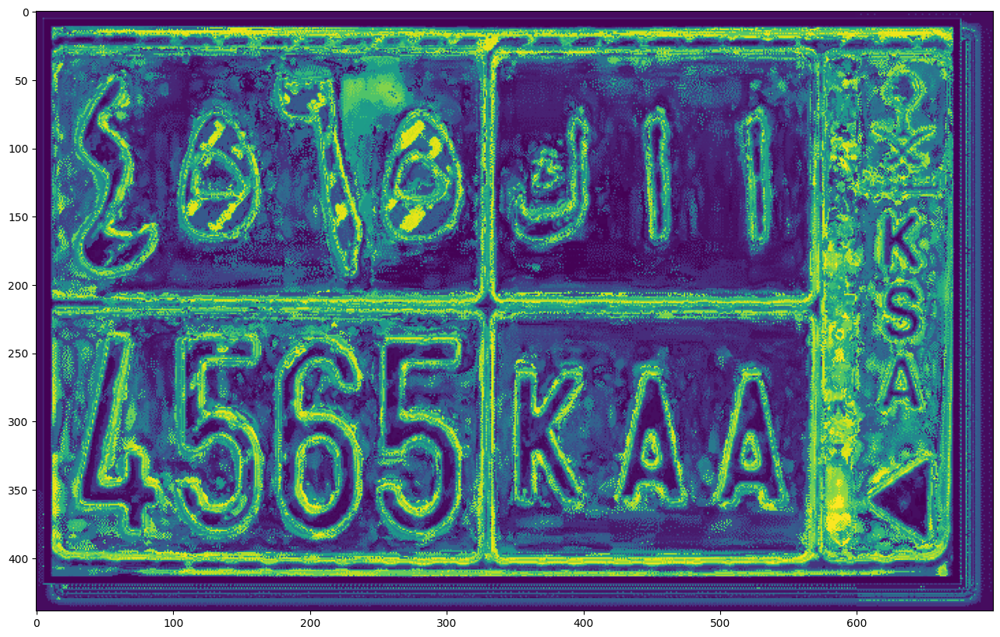

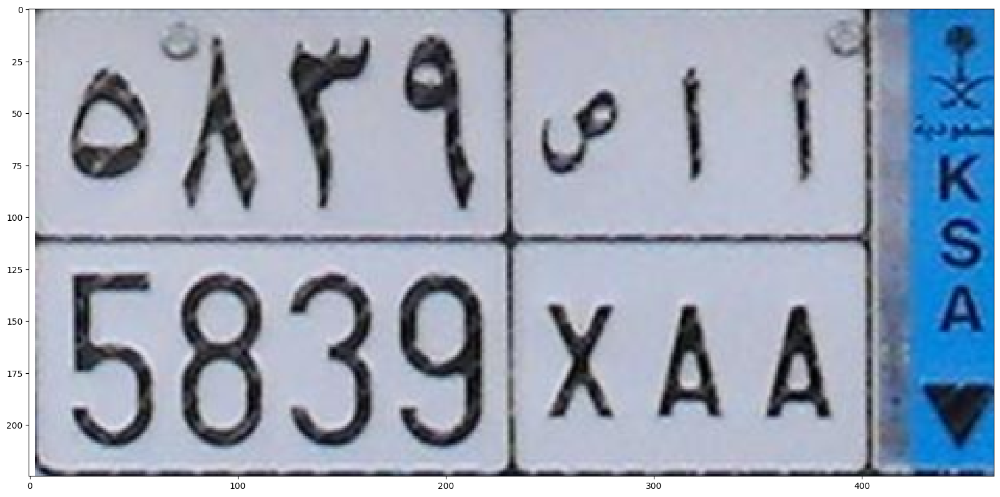

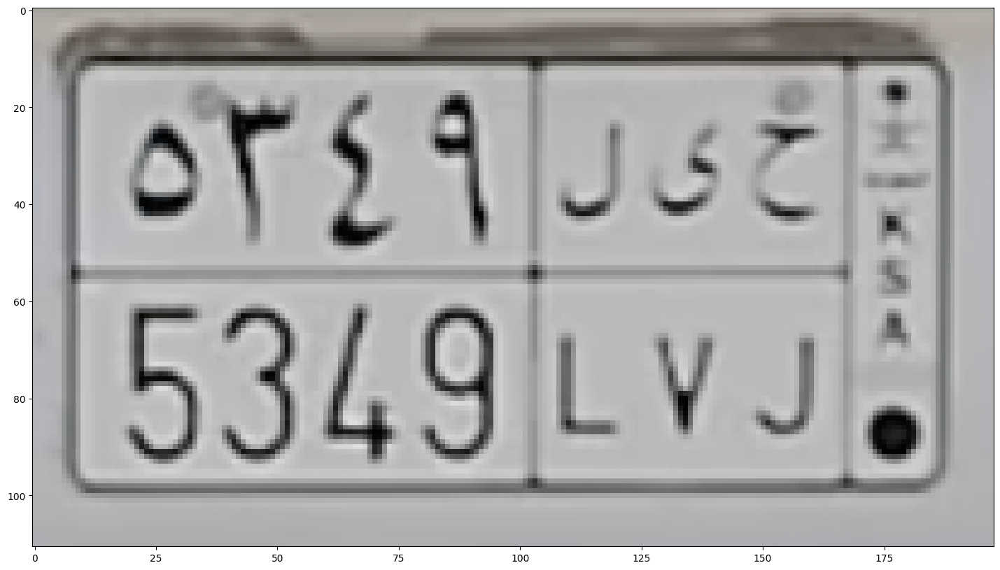

...

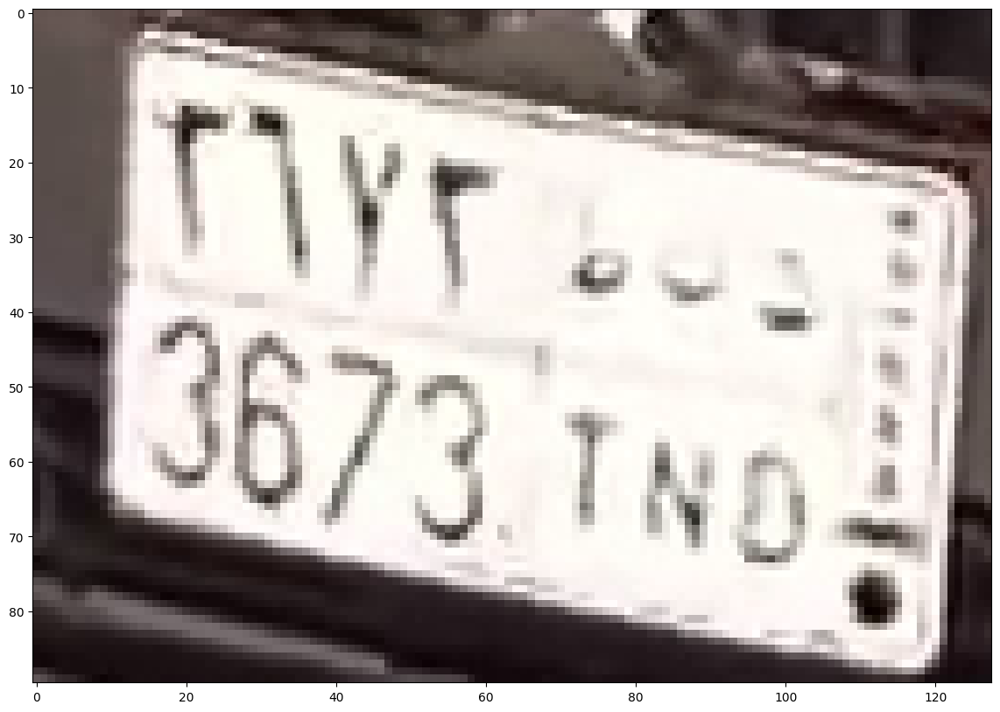

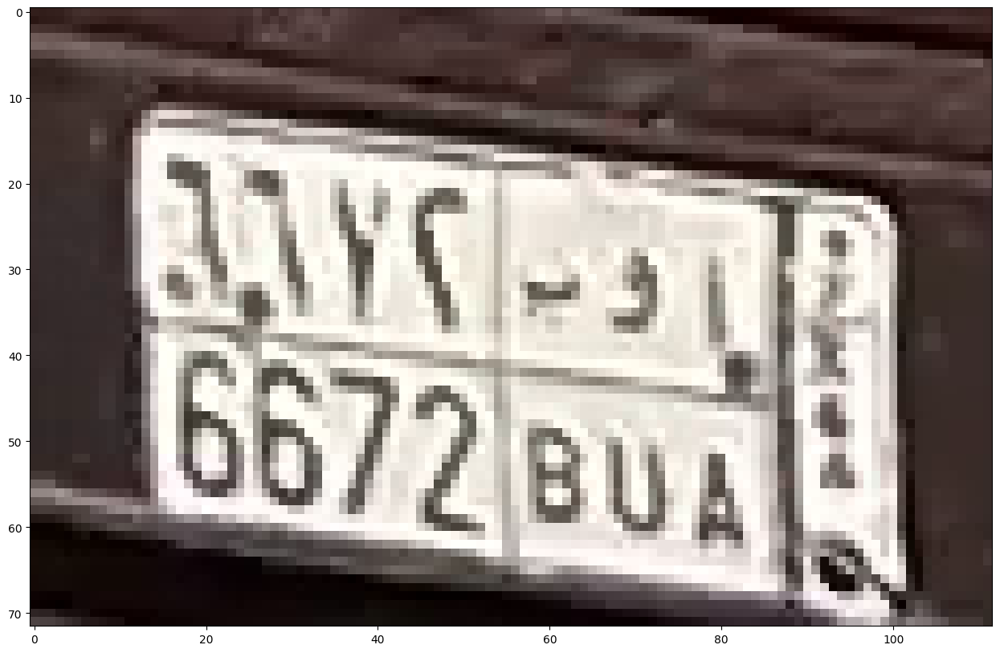

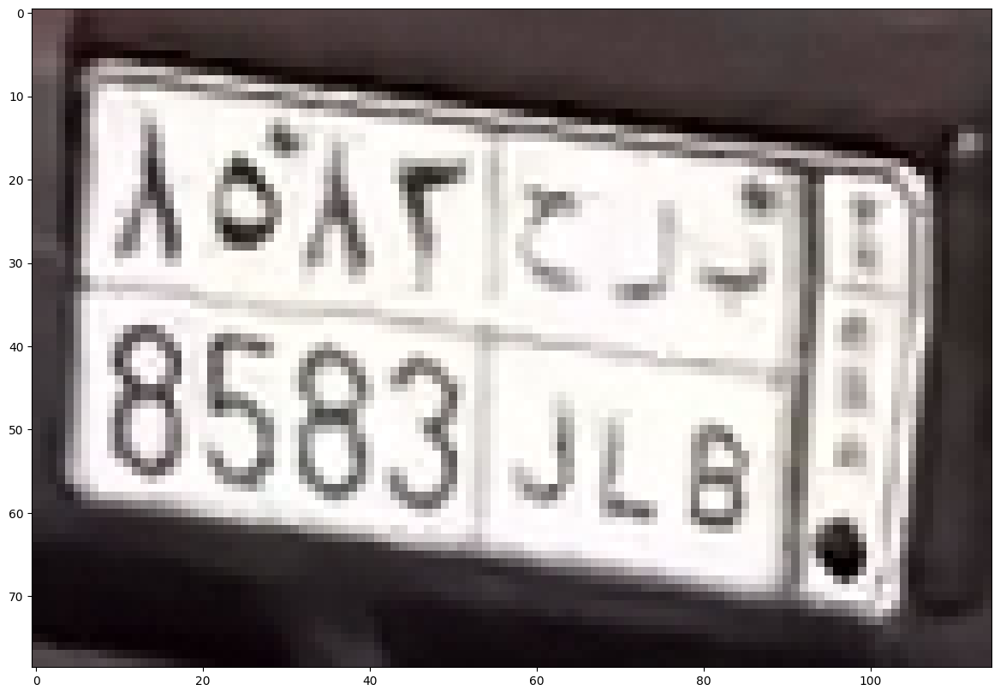

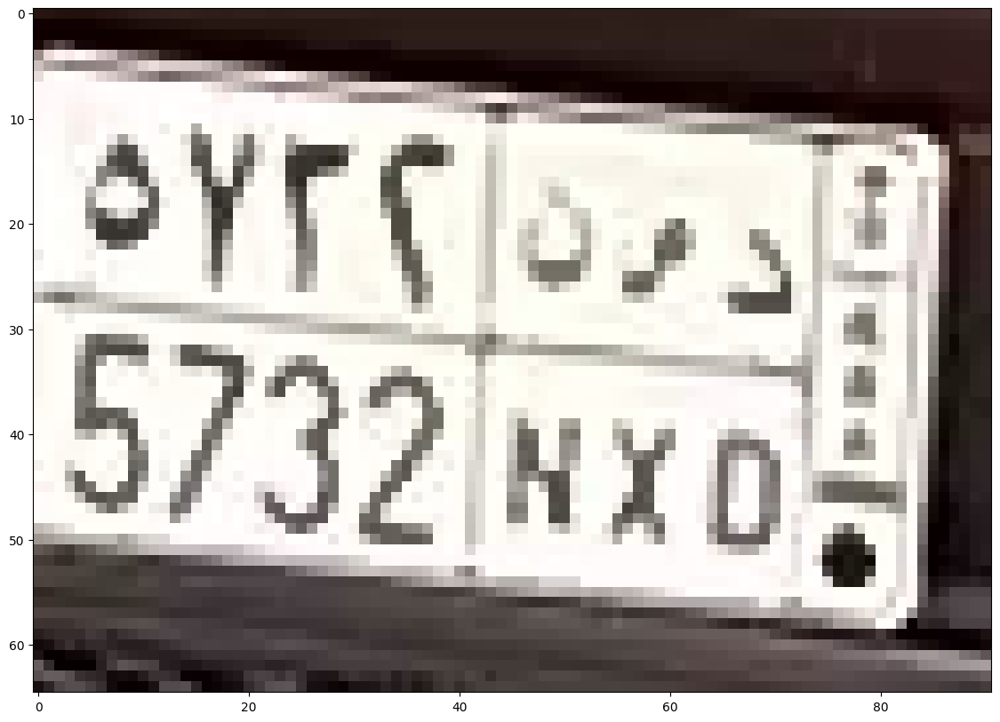

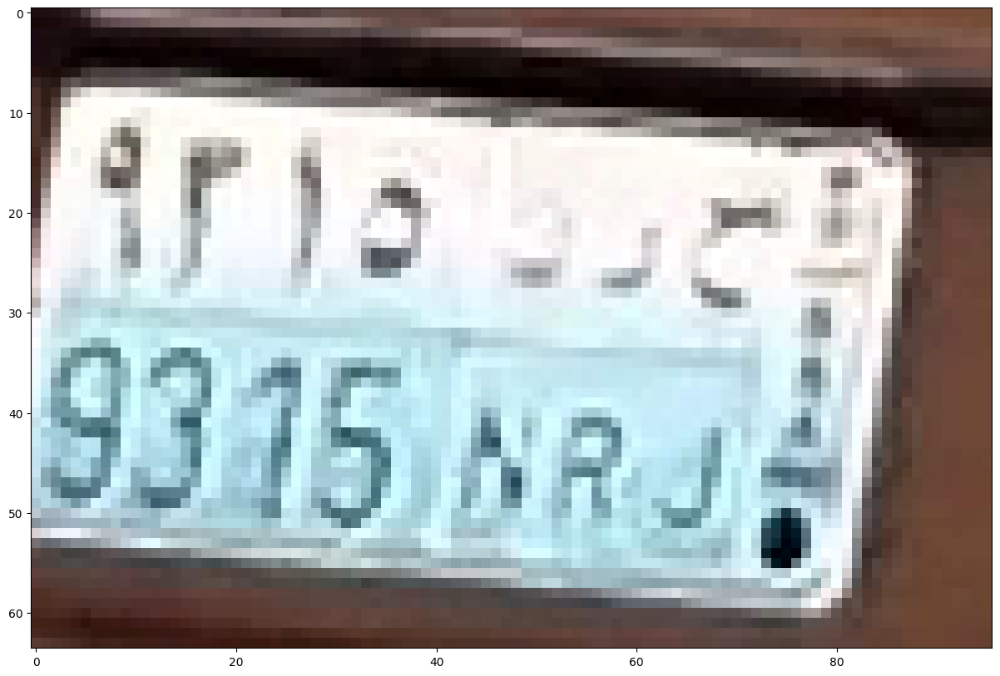

In [ ]:
for path in tpaths2:
    image = Image.open(path)
    image=np.array(image)
    plt.figure(figsize=(20,10))
    plt.imshow(image)
    plt.show()

# Predict

In [ ]:
best_path0='runs/detect/train/weights/best.pt'
source0='datasets/test'

In [ ]:
model2 = YOLO(best_path0)

FileNotFoundError: [Errno 2] No such file or directory: 'runs/detect/train/weights/best.pt'

In [ ]:
!ls /path/to/your

In [ ]:
import os

# ... your existing code ...

# Print the value of best_path0 to check if it's correct
print(f"Best path: {best_path0}")

# Check if the file exists
if os.path.exists(best_path0):
    model2 = YOLO(best_path0)
else:
    print(f"Error: File not found at {best_path0}")

Best path: runs/detect/train/weights/best.pt
Error: File not found at runs/detect/train/weights/best.pt


In [ ]:
!yolo task=detect mode=predict model={best_path0} conf=0.01 source={source0}

# Result of Prediction

In [ ]:
results = model2.predict(source0,conf=0.01)
print(len(results))

In [ ]:
print(results[0].boxes.data)

In [ ]:
PBOX=pd.DataFrame(columns=range(6))
for i in range(len(results)):#len(results)
    if len(results[i].boxes.data)>0:
        arri=pd.DataFrame(results[i].boxes.data.cpu().numpy()).astype(float)
        path=ppaths[i]
        file=path.split('/')[-1]
        arri=arri.assign(file=file)
        arri=arri.assign(i=i)
        PBOX=pd.concat([PBOX,arri],axis=0)
PBOX.columns=['x','y','x2','y2','confidence','class','file','i']
display(PBOX)

In [ ]:
PBOX['class']=PBOX['class'].apply(lambda x: class_map[int(x)])
PBOX=PBOX.reset_index(drop=True)
display(PBOX)
display(PBOX['class'].value_counts())

In [ ]:
color_codes = [
    '#FF0000',  # Red
    '#FF4500',  # OrangeRed
    '#FF8C00',  # DarkOrange
    '#FFA500',  # Orange
    '#FFD700',  # Gold
    '#FFFF00',  # Yellow
    '#ADFF2F',  # GreenYellow
    '#7FFF00',  # Chartreuse
    '#00FF00',  # Lime
    '#00FA9A',  # MediumSpringGreen
    '#00FFFF',  # Cyan
    '#00BFFF',  # DeepSkyBlue
    '#0000FF',  # Blue
    '#8A2BE2'   # BlueViolet
]
colors=[]
for c in color_codes:
    colors += [tuple((int(c[1:3],16),int(c[3:5],16),int(c[5:7],16)))]

In [ ]:
def draw_box2(n0):

    ipath=ppaths[n0]
    image=cv2.imread(ipath)
    H,W=image.shape[0],image.shape[1]
    file=ipath.split('/')[-1]

    if PBOX[PBOX['file']==file] is not None:
        box=PBOX[PBOX['file']==file]
        box=box.reset_index(drop=True)
        #display(box)

        for i in range(len(box)):
            label=box.iloc[i,5]
            x=int(box.iloc[i,0])
            y=int(box.iloc[i,1])
            x2=int(box.iloc[i,2])
            y2=int(box.iloc[i,3])
            #print(label,x,y,x2,y2)
            ci=colors[int(label)%14]
            cv2.rectangle(image,(x,y),(x2,y2),ci,1)

    #plt.imshow(image)
    #plt.show()

    return image

In [ ]:
images2=[]
for i in tqdm(range(len(ppaths))):
    images2+=[draw_box2(i)]

In [ ]:
create_animation(images2)